In [1]:
from PIL import Image
import pandas as pd
import numpy as np
import json
import os
from sklearn.manifold import TSNE
from scipy.cluster.hierarchy import dendrogram, linkage
import matplotlib.pyplot as plt
import tqdm

# Get Data

In [2]:
path = '../../data/StatHD/MLW/'

f = open(os.path.join(path, 'data.json'))
data_tmp = json.load(f)
f.close()
data = pd.DataFrame(data_tmp)

In [3]:
data_id = np.asarray(data['id'])
np.random.shuffle(data_id)
files = list(map(lambda e: str(e) + '.jpg', np.random.choice(data_id, 500)))

In [4]:
path_images = os.path.join(path, 'zettel')

def get_meta(files):
    for file in tqdm.tqdm(files):
        img = np.array(Image.open(os.path.join(path_images, file), mode="r"))
        yield np.concatenate((
            np.mean(img, axis=tuple(range(img.ndim-1))),
            np.std(img, axis=tuple(range(img.ndim-1))),
            np.array(img.shape)))

In [5]:
ls = get_meta(files)

# Compute relevant values lazy

In [6]:
r_m = []
g_m = []
b_m = []

r_sd = []
g_sd = []
b_sd = []

x = []
y = []

for l in ls:
    r_m.append(l[0])
    g_m.append(l[1])
    b_m.append(l[2])

    r_sd.append(l[3])
    g_sd.append(l[4])
    b_sd.append(l[5])

    x.append(l[6])
    y.append(l[7])


100%|██████████| 500/500 [04:23<00:00,  1.90it/s]


In [7]:
data_trunc = pd.DataFrame({
    'files': files,
    'r_m': r_m,
    'g_m': g_m,
    'b_m': b_m,
    'r_sd': r_sd,
    'g_sd': g_sd,
    'b_sd': b_sd,
    'x': x,
    'y':y
    })

In [8]:
data_trunc

,files,r_m,g_m,b_m,r_sd,g_sd,b_sd,x,y
0,281919.jpg,232.506331,193.560109,165.329980,45.754354,40.453684,36.790139,1150.0,1712.0
1,38347.jpg,232.631730,203.331607,181.783132,49.082572,45.844526,43.074575,1206.0,1714.0
2,196765.jpg,238.820435,214.804302,191.257598,41.444983,40.401104,37.586686,1202.0,1705.0
3,220638.jpg,229.917273,194.839656,168.583560,49.334246,44.075260,40.055137,1147.0,1716.0
4,226924.jpg,240.133345,228.660375,212.241690,33.954404,34.430481,33.866135,1207.0,1719.0
...,...,...,...,...,...,...,...,...,...
495,215240.jpg,238.203909,209.437070,185.616225,39.505646,37.104743,35.136860,1223.0,1738.0
496,286535.jpg,235.691514,201.016636,178.983497,32.646166,29.301537,28.051753,1232.0,1723.0
497,208259.jpg,231.025437,202.761640,181.256474,51.068220,48.134092,45.084144,1192.0,1715.0
498,215850.jpg,235.711428,210.931267,187.142747,44.282823,42.434562,39.643745,1233.0,1753.0


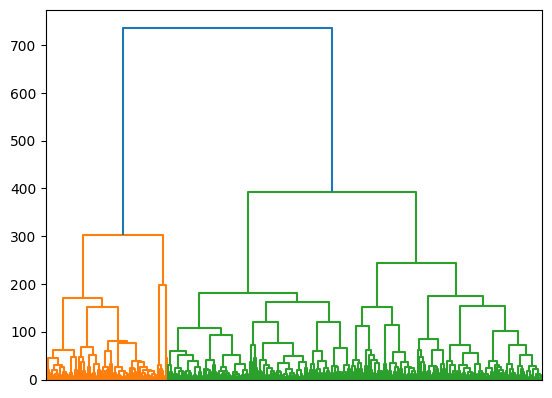

In [16]:
linkage_data = linkage(data_trunc.loc[:, data_trunc.columns != 'files'], method='ward', metric='euclidean')
cluster = dendrogram(linkage_data, get_leaves=True)
plt.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False) # labels along the bottom edge are off

In [10]:
cluster.keys()

dict_keys(['icoord', 'dcoord', 'ivl', 'leaves', 'color_list', 'leaves_color_list'])

In [11]:
cluster_l = list(zip(cluster['leaves'], cluster['leaves_color_list']))

In [12]:
slice1 = list(map(lambda e: e[0], list(filter(lambda e: e[1] == 'C1', cluster_l))))
slice2 = list(map(lambda e: e[0], list(filter(lambda e: e[1] == 'C2', cluster_l))))

In [13]:
def plot_sample(df, slice):
    columns = 4
    rows = 5
    
    data_slice = df.iloc[slice]
    slice = data_slice['files'].values
    sample = np.random.choice(slice, columns * rows)
    fig = plt.figure(figsize=(40, 40))
    path_images = os.path.join(path, 'zettel')
    for index, file in enumerate(sample):
        img = np.array(Image.open(os.path.join(path_images, file), mode="r"))
        fig.add_subplot(rows, columns, index + 1)
        plt.imshow(img)
    plt.show()

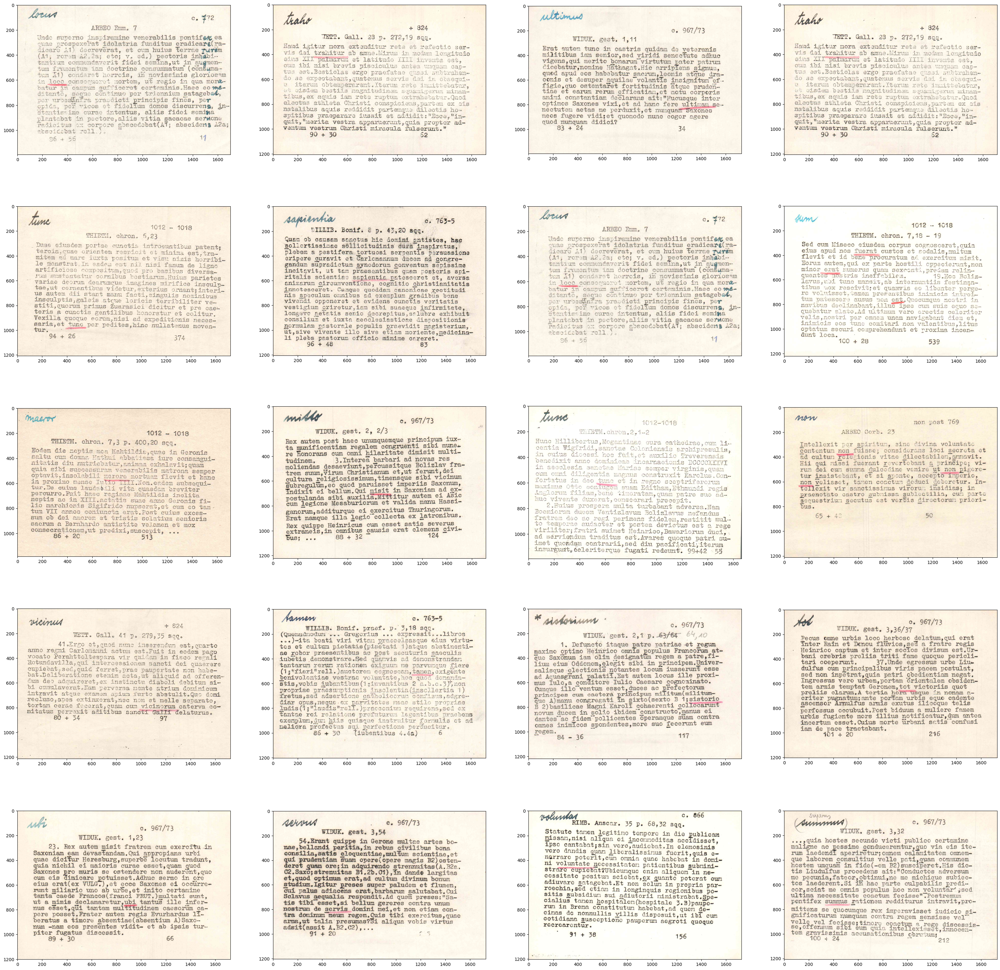

In [14]:
plot_sample(data_trunc, slice1)

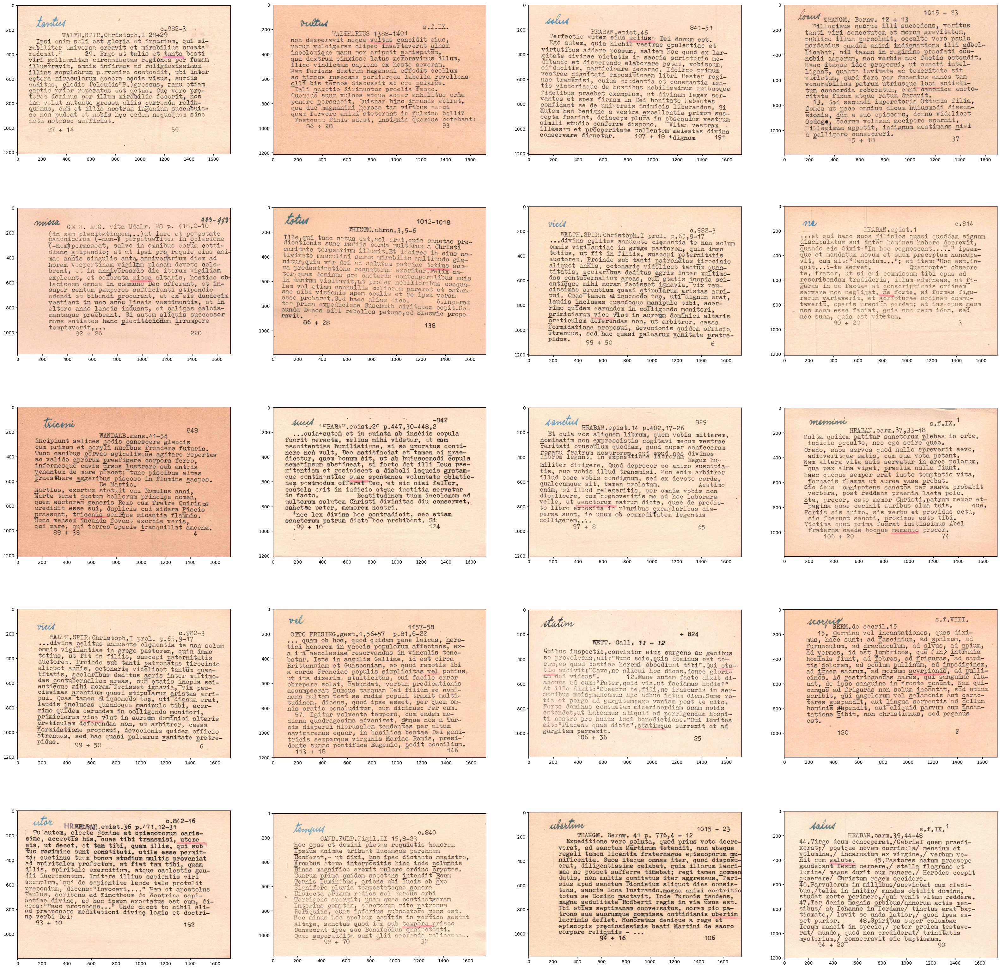

In [15]:
plot_sample(data_trunc, slice2)

# Observation
- Two clusters can be seen
- Similar behavior as seen in T-SNE and UMAP